Load packages to be used

In [51]:
import Pkg; Pkg.add("ITensorMPS")

   Resolving package versions...
   Installed ITensorMPS ── v0.2.5
   Installed ITensorTDVP ─ v0.4.9
    Updating `~/.julia/environments/v1.10/Project.toml`
  [0d1a4710] + ITensorMPS v0.2.5
    Updating `~/.julia/environments/v1.10/Manifest.toml`
  [0d1a4710] + ITensorMPS v0.2.5
  [25707e16] + ITensorTDVP v0.4.9
Precompiling project...
  ✓ ITensorTDVP
  ✓ ITensorMPS
  2 dependencies successfully precompiled in 10 seconds. 373 already precompiled.


In [29]:
using LinearAlgebra
using Plots
using Images

Load and show photo

In [30]:
print("Hello World")


Hello World

In [31]:
Photo = load("/Users/user/Desktop/codes/labcodes/stack14.png");
size(Photo)

(1920, 2560)

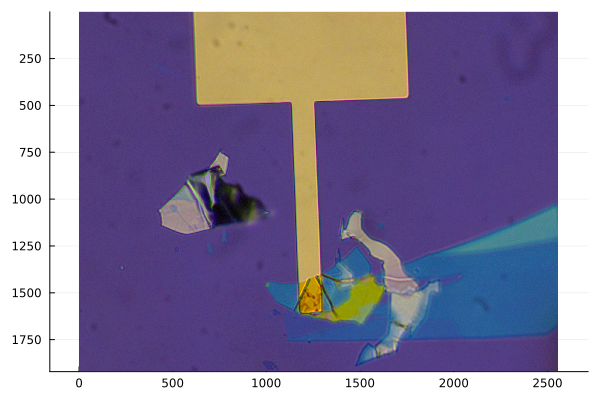

In [61]:
plot(RGB.(Photo))

Perform SVD and truncate

In [109]:
img_CHW = channelview(Photo) 
pho_HWC = permutedims(img_CHW, (2, 3, 1))

1920×2560×3 Array{N0f8,3} with eltype N0f8:
[:, :, 1] =
 0.31   0.314  0.333  0.333  0.333  …  0.31   0.31   0.29   0.31   0.322
 0.314  0.31   0.314  0.322  0.329     0.302  0.29   0.302  0.294  0.294
 0.329  0.31   0.31   0.302  0.322     0.29   0.294  0.31   0.31   0.314
 0.314  0.294  0.302  0.31   0.31      0.282  0.29   0.282  0.314  0.31
 0.322  0.31   0.322  0.31   0.31      0.267  0.29   0.29   0.302  0.29
 0.31   0.329  0.322  0.322  0.31   …  0.29   0.282  0.302  0.302  0.314
 0.329  0.341  0.333  0.31   0.31      0.294  0.294  0.29   0.31   0.31
 0.302  0.329  0.329  0.31   0.302     0.29   0.294  0.302  0.31   0.282
 0.302  0.302  0.322  0.302  0.302     0.294  0.302  0.29   0.294  0.29
 0.302  0.29   0.31   0.322  0.31      0.302  0.282  0.29   0.29   0.29
 ⋮                                  ⋱  ⋮                           
 0.322  0.333  0.31   0.294  0.31      0.275  0.282  0.267  0.267  0.251
 0.329  0.322  0.322  0.314  0.322     0.275  0.29   0.275  0.275  0.267
 0.32

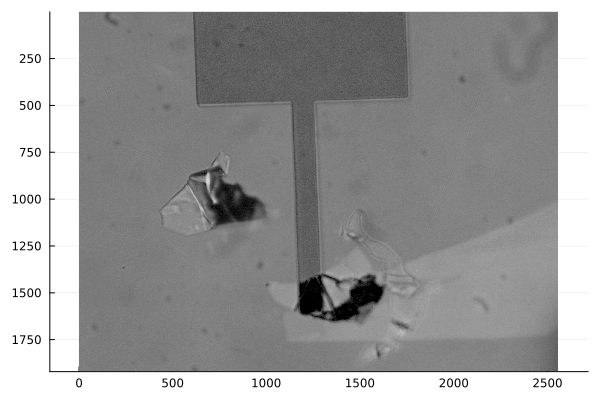

In [117]:
img_1=pho_HWC[:,:,3]
plot(Gray.(img_1))

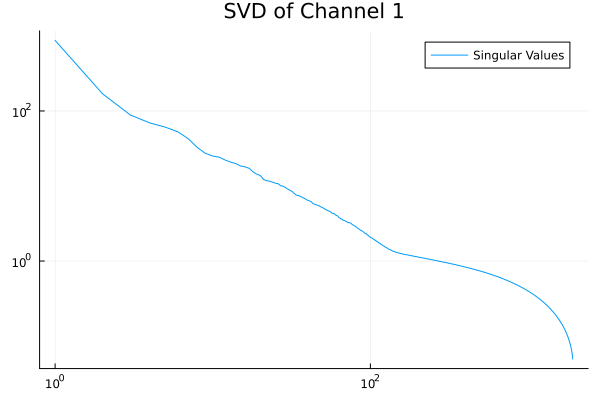

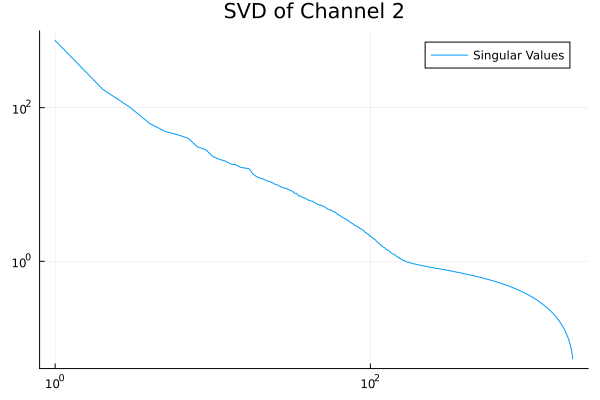

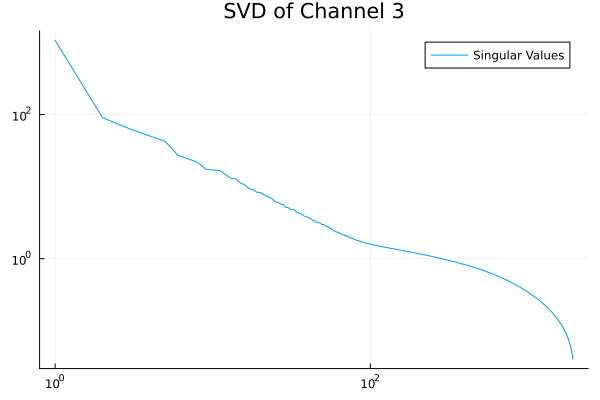

In [132]:

for i = 1:3
    img=pho_HWC[:,:,i];
    PhotoSVD = svd(Gray.(img));
    p=plot(PhotoSVD.S, xaxis=:log, yaxis=:log,title="SVD of Channel $i", label="Singular Values");
    display(p)
end

In [135]:
size(pho_HWC)

(1920, 2560, 3)

In [139]:
zeros(size(pho_HWC))

1920×2560×3 Array{Float64, 3}:
[:, :, 1] =
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 ⋮                        ⋮              ⋱            ⋮                   
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0

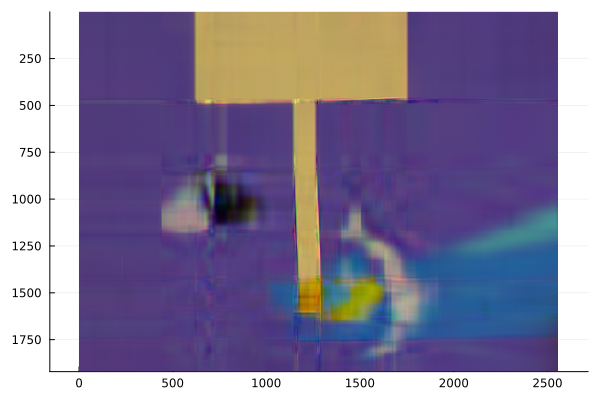

In [141]:
# First define χ and the remaining number of singular values

χ = 10;

Compressed= zeros(size(pho_HWC))
for i = 1:3
    img=pho_HWC[:,:,i];
    PhotoSVD = svd(Gray.(img));
    n = size(PhotoSVD.S,1)
    rem = n-χ;
    # Keep only χ singular values
    Sapprox=Diagonal(copy(PhotoSVD.S));
    for k = 1:rem
        Sapprox[n+1-k,n+1-k]=0;
    end
    Compressed[:,:,i] = PhotoSVD.U*Sapprox*PhotoSVD.Vt;
end
Compressed_rgb = permutedims(Compressed, (3, 1, 2))

# Create RGB image and plot
com_rgb = colorview(RGB, Compressed_rgb)
plot(com_rgb)


In [35]:
PhotoSVD = svd(Gray.(Photo));

In [36]:
size(PhotoSVD.Vt)

(1920, 2560)

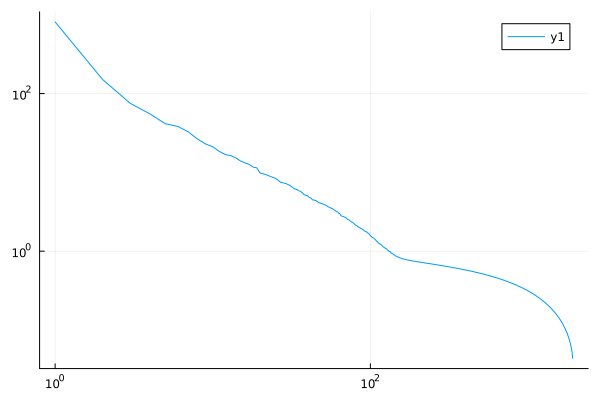

In [37]:
plot(PhotoSVD.S, xaxis=:log, yaxis=:log)

In [83]:
# First define χ and the remaining number of singular values
n = size(PhotoSVD.S,1)
χ = 10;
rem = n-χ;

# Keep only χ singular values
Sapprox=Diagonal(copy(PhotoSVD.S));
for k = 1:rem
    Sapprox[n+1-k,n+1-k]=0;
end

# Calculate approximated matrix
Compressed = PhotoSVD.U*Sapprox*PhotoSVD.Vt;

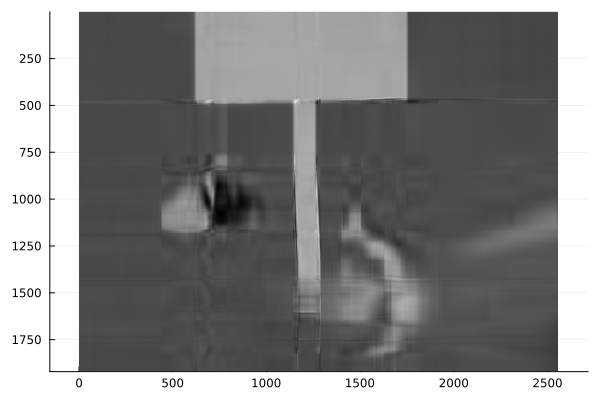

In [84]:
plot(Gray.(Compressed))

End of example

In [48]:
using ITensors
let
  i = Index(4,"i")
  j = Index(4,"j")
  k = Index(4,"k")
  l = Index(4,"l")
  T = random_itensor(i,j,k,l)
  U,S,V = svd(T,i,k)   # compute SVD with (i,k) as row indices (indices of U)
  @show hasinds(U,i,k) # = true
  @show hasinds(V,j,l) # = true
  @show T ≈ U*S*V      # = true

  nothing
end

# output

hasinds(U, i, k) = true
hasinds(V, j, l) = true
T ≈ U * S * V = true

hasinds(U, i, k) = true
hasinds(V, j, l) = true
T ≈ U * S * V = true


ErrorException: invalid method definition in Main: function ITensors.hasinds must be explicitly imported to be extended

In [49]:
using ITensors
let
  i = Index(10)           # index of dimension 10
  j = Index(20)           # index of dimension 20
  M = random_itensor(i,j)  # random matrix, indices i,j
  U,S,V = svd(M,i)        # compute SVD with i as row index
  @show M ≈ U*S*V         # = true

  nothing
end

# output

M ≈ U * S * V = true

M ≈ U * S * V = true


ErrorException: syntax: "*(U, S, V)" is not a valid function argument name around /Users/user/Desktop/codes/SVD_FigureCompression_Gray.ipynb:14

In [52]:
using ITensors, ITensorMPS
let
  # Create 100 spin-one indices
  N = 100
  sites = siteinds("S=1",N)

  # Input operator terms which define
  # a Hamiltonian matrix, and convert
  # these terms to an MPO tensor network
  # (here we make the 1D Heisenberg model)
  os = OpSum()
  for j=1:N-1
    os += "Sz",j,"Sz",j+1
    os += 0.5,"S+",j,"S-",j+1
    os += 0.5,"S-",j,"S+",j+1
  end
  H = MPO(os,sites)

  # Create an initial random matrix product state
  psi0 = random_mps(sites)

  # Plan to do 5 passes or 'sweeps' of DMRG,
  # setting maximum MPS internal dimensions
  # for each sweep and maximum truncation cutoff
  # used when adapting internal dimensions:
  nsweeps = 5
  maxdim = [10,20,100,100,200]
  cutoff = 1E-10

  # Run the DMRG algorithm, returning energy
  # (dominant eigenvalue) and optimized MPS
  energy, psi = dmrg(H,psi0; nsweeps, maxdim, cutoff)
  println("Final energy = $energy")

  nothing
end

# output

After sweep 1 energy=-137.954199761732 maxlinkdim=9 maxerr=2.43E-16 time=9.356
After sweep 2 energy=-138.935058943878 maxlinkdim=20 maxerr=4.97E-06 time=0.671
After sweep 3 energy=-138.940080155429 maxlinkdim=92 maxerr=1.00E-10 time=4.522
After sweep 4 energy=-138.940086009318 maxlinkdim=100 maxerr=1.05E-10 time=11.644
After sweep 5 energy=-138.940086058840 maxlinkdim=96 maxerr=1.00E-10 time=12.771
Final energy = -138.94008605883985

After sweep 1 energy=-137.4312246441133  maxlinkdim=9 maxerr=2.13E-11 time=19.584
After sweep 2 energy=-138.93249959811973  maxlinkdim=20 maxerr=5.32E-06 time=0.821
After sweep 3 energy=-138.94006809982596  maxlinkdim=92 maxerr=1.00E-10 time=4.935
After sweep 4 energy=-138.9400855744479  maxlinkdim=100 maxerr=1.00E-10 time=10.997
After sweep 5 energy=-138.94008606110586  maxlinkdim=101 maxerr=9.99E-11 time=13.010
Final energy = -138.94008606110586


UndefVarError: UndefVarError: `After` not defined

In [76]:
using ITensors

let
  # ... your own code goes here ...
  # For example:
  i = Index(2,"i")
  j = Index(3,"j")
  T = random_itensor(i,j)
  @show T
end

T = ITensor ord=2
Dim 1: (dim=2|id=890|"i")
Dim 2: (dim=3|id=297|"j")
NDTensors.Dense{Float64, Vector{Float64}}
 2×3
  0.9630454976343803   -2.2010632144096856  -0.0053199884035626
 -0.03674831999469929  -0.194890395310731   -0.19521868076711282


ITensor ord=2 (dim=2|id=890|"i") (dim=3|id=297|"j")
NDTensors.Dense{Float64, Vector{Float64}}

In [54]:
i = Index(3,"index_i")
j = Index(2,"index_j")
k = Index(4,"index_k")

T = ITensor(i,j,k)

ITensor ord=3 (dim=3|id=952|"index_i") (dim=2|id=858|"index_j") (dim=4|id=15|"index_k")
NDTensors.EmptyStorage{NDTensors.EmptyNumber, NDTensors.Dense{NDTensors.EmptyNumber, Vector{NDTensors.EmptyNumber}}}

In [55]:
@show inds(T)

inds(T) = ((dim=3|id=952|"index_i"), (dim=2|id=858|"index_j"), (dim=4|id=15|"index_k"))


((dim=3|id=952|"index_i"), (dim=2|id=858|"index_j"), (dim=4|id=15|"index_k"))

In [57]:
T[i=>2,j=>1,k=>3] = -3.2
# Both of these lines of code do the same thing:
T[j=>1,i=>2,k=>3] = -3.2
T[j=>1,k=>3,i=>2] = -3.2
el = T[j=>1,i=>2,k=>3]
println("The (i,j,k) = (2,1,3) element of T is ",el)


The (i,j,k) = (2,1,3) element of T is -3.2


In [59]:
M = [1.0 2.0;
     3.0 4.0]

i = Index(2,"i")
j = Index(2,"j")

A = ITensor(M,i,j)
@show A

A = ITensor ord=2
Dim 1: (dim=2|id=454|"i")
Dim 2: (dim=2|id=323|"j")
NDTensors.Dense{Float64, Vector{Float64}}
 2×2
 1.0  2.0
 3.0  4.0


ITensor ord=2 (dim=2|id=454|"i") (dim=2|id=323|"j")
NDTensors.Dense{Float64, Vector{Float64}}

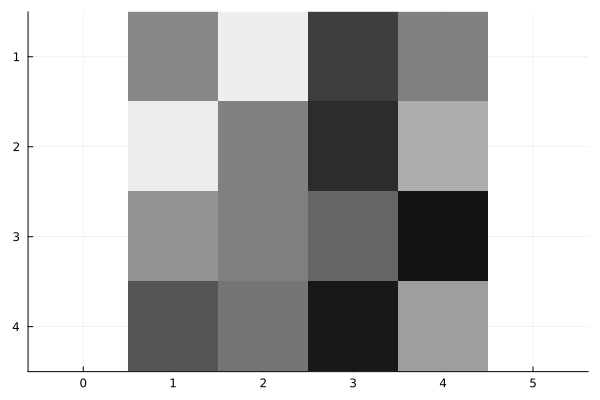

In [67]:
img_num = rand(4, 4)

img_gray_copy = Gray.(img_num) # construction
img_num_copy = Float64.(img_gray_copy) # construction

img_gray_view = colorview(Gray, img_num) # view
img_num_view = channelview(img_gray_view) # view
plot(RGB.(img_num) )

In [74]:
o=Array{ColorTypes.RGB{Float32},2}
plot(o)

ErrorException: Cannot convert DataType to series data for plotting

┌ Info: Saved animation to /var/folders/9j/l5f2m88j573_gw21qqyrlcdm0000gn/T/jl_MR6XMpKX0x.gif
└ @ Plots /Users/user/.julia/packages/Plots/kLeqV/src/animation.jl:156


Plots.AnimatedGif("/var/folders/9j/l5f2m88j573_gw21qqyrlcdm0000gn/T/jl_MR6XMpKX0x.gif")
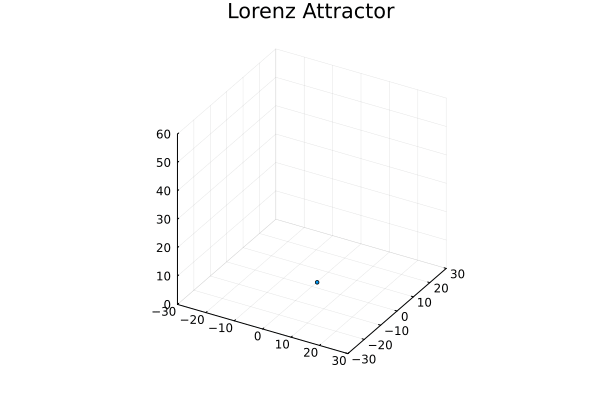

In [75]:
using Plots
# define the Lorenz attractor
Base.@kwdef mutable struct Lorenz
    dt::Float64 = 0.02
    σ::Float64 = 10
    ρ::Float64 = 28
    β::Float64 = 8/3
    x::Float64 = 1
    y::Float64 = 1
    z::Float64 = 1
end

function step!(l::Lorenz)
    dx = l.σ * (l.y - l.x)
    dy = l.x * (l.ρ - l.z) - l.y
    dz = l.x * l.y - l.β * l.z
    l.x += l.dt * dx
    l.y += l.dt * dy
    l.z += l.dt * dz
end

attractor = Lorenz()


# initialize a 3D plot with 1 empty series
plt = plot3d(
    1,
    xlim = (-30, 30),
    ylim = (-30, 30),
    zlim = (0, 60),
    title = "Lorenz Attractor",
    legend = false,
    marker = 2,
)

# build an animated gif by pushing new points to the plot, saving every 10th frame
@gif for i=1:1500
    step!(attractor)
    push!(plt, attractor.x, attractor.y, attractor.z)
end every 10

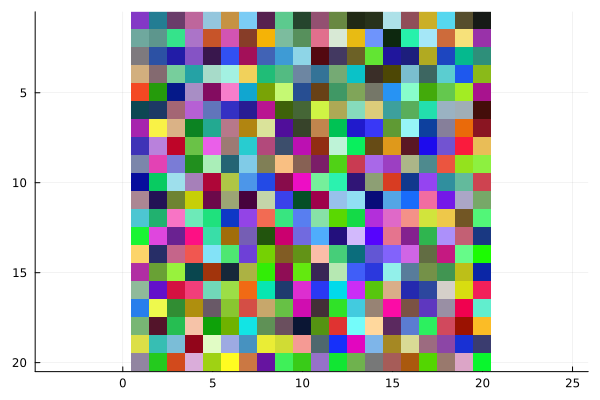

In [91]:
img_rgb = rand(RGB, 20, 20)
size(img_rgb)
plot(img_rgb)

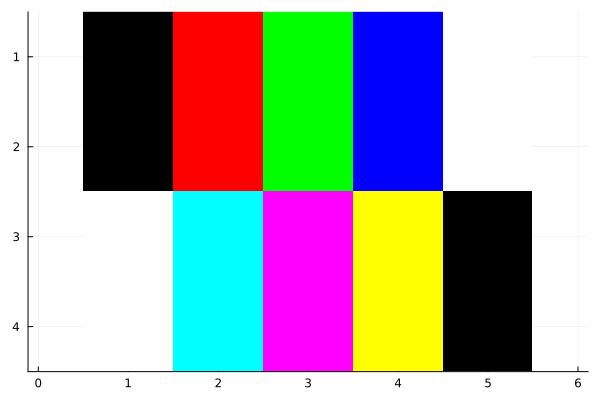

In [126]:
img_rgb = [
    RGB(0.0, 0.0, 0.0) RGB(1.0, 0.0, 0.0) RGB(0.0, 1.0, 0.0) RGB(0.0, 0.0, 1.0) RGB(1.0, 1.0, 1.0)
    RGB(0.0, 0.0, 0.0) RGB(1.0, 0.0, 0.0) RGB(0.0, 1.0, 0.0) RGB(0.0, 0.0, 1.0) RGB(1.0, 1.0, 1.0)
    RGB(1.0, 1.0, 1.0) RGB(0.0, 1.0, 1.0) RGB(1.0, 0.0, 1.0) RGB(1.0, 1.0, 0.0) RGB(0.0, 0.0, 0.0)
    RGB(1.0, 1.0, 1.0) RGB(0.0, 1.0, 1.0) RGB(1.0, 0.0, 1.0) RGB(1.0, 1.0, 0.0) RGB(0.0, 0.0, 0.0)
    ]
plot(RGB.(img_rgb))

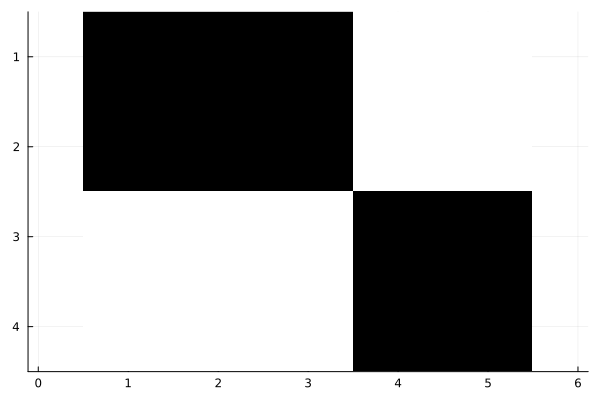

In [130]:
img_CHW = channelview(img_rgb) 
img_HWC = permutedims(img_CHW, (2, 3, 1))
#size(img_HWC)
img_r=img_HWC[:,:,3]
plot(Gray.(img_r))
#figure;
#plot(RGB.(img_rgb))

# SVD compression of colored photos ##

In [167]:
using LinearAlgebra
using Plots
using Images
using ITensors

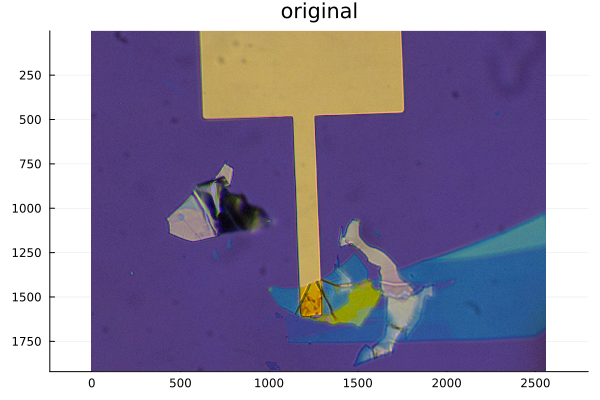

(1920, 2560)

In [168]:
Photo = load("/Users/user/Desktop/codes/labcodes/stack14.png");
print(size(Photo))
p1=plot(RGB.(Photo),title="original")
display(p1)



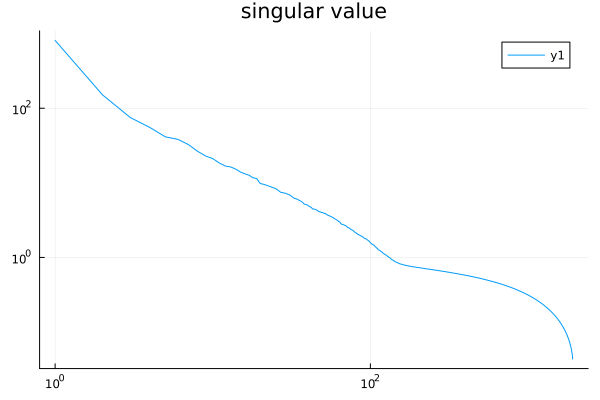

In [169]:
PhotoSVD = svd(Gray.(Photo));
plot(PhotoSVD.S, xaxis=:log, yaxis=:log,title="singular value")

***'<big>'How many singular values will be kept***

In [178]:
χ = 3;

**Compressing images in all three channels**

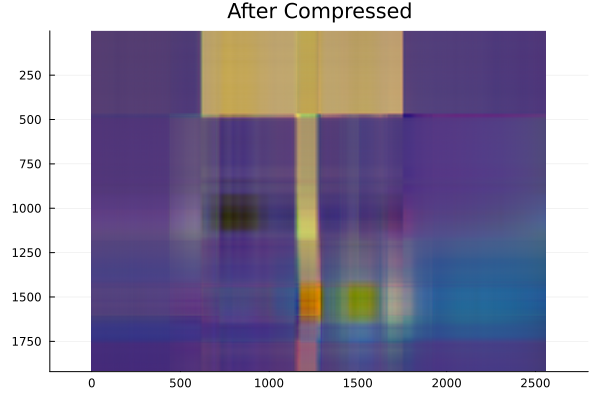

In [179]:

img_CHW = channelview(Photo) 
pho_HWC = permutedims(img_CHW, (2, 3, 1))
Compressed= zeros(size(pho_HWC))
for i = 1:3
    img=pho_HWC[:,:,i];
    PhotoSVD = svd(Gray.(img));
    n = size(PhotoSVD.S,1)
    rem = n-χ;
    # Keep only χ singular values
    Sapprox=Diagonal(copy(PhotoSVD.S));
    for k = 1:rem
        Sapprox[n+1-k,n+1-k]=0;
    end
    Compressed[:,:,i] = PhotoSVD.U*Sapprox*PhotoSVD.Vt;
end
Compressed_rgb = permutedims(Compressed, (3, 1, 2))

# Create RGB image and plot
com_rgb = colorview(RGB, Compressed_rgb)
plot(com_rgb,title="After Compressed")

In [1]:
using ITensors

In [16]:
i= Index(2);
j=Index(4);
k=Index(3);
aᵢ=Index(5)

(dim=5|id=761)

In [4]:
@show aᵢ;

aᵢ = (dim=5|id=983)


In [5]:
@show i,j;

(i, j) = ((dim=2|id=629), (dim=4|id=44))


In [9]:
A=ITensor(i,j);
A[i=>1,j=>1]=2.0;
A[i=>2,j=>4]=0.5;
@show A;

A = ITensor ord=2
Dim 1: (dim=2|id=629)
Dim 2: (dim=4|id=44)
NDTensors.Dense{Float64, Vector{Float64}}
 2×4
 2.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.5


In [12]:
@show inds(A);

inds(A) = ((dim=2|id=629), (dim=4|id=44))


In [13]:
new=Array(A,i,j);
@show new

new = [2.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.5]


2×4 Matrix{Float64}:
 2.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.5

In [15]:
B=ITensor(new,i,j);
@show B

B = ITensor ord=2
Dim 1: (dim=2|id=629)
Dim 2: (dim=4|id=44)
NDTensors.Dense{Float64, Vector{Float64}}
 2×4
 2.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.5


ITensor ord=2 (dim=2|id=629) (dim=4|id=44)
NDTensors.Dense{Float64, Vector{Float64}}

In [26]:
P=randomITensor(i,j,k);
@show P

P = ITensor ord=3
Dim 1: (dim=2|id=78)
Dim 2: (dim=4|id=473)
Dim 3: (dim=3|id=828)
NDTensors.Dense{Float64, Vector{Float64}}
 2×4×3
[:, :, 1] =
 -1.9762123983254636   -0.29092477588845034  -0.23739964237403965   1.358385936434433
  0.17609990108942195  -1.0258885186669318    0.13651393789928185  -0.12412741404701247

[:, :, 2] =
 -1.6359344712457056    1.8260805625266938   0.7430936322800196   1.4810272850742245
  0.03706288888930486  -0.7673254583550088  -0.2787860439442751  -1.6847143750837075

[:, :, 3] =
  0.3476635378040829  0.4008840305185703    -0.14681046782650578   1.106330780637994
 -0.6393746945781611  0.047021164098689255   0.4199810589881061   -1.5907865357853719


ITensor ord=3 (dim=2|id=78) (dim=4|id=473) (dim=3|id=828)
NDTensors.Dense{Float64, Vector{Float64}}

In [23]:
B=randomITensor(j,k);
@show B

B = ITensor ord=2
Dim 1: (dim=4|id=473)
Dim 2: (dim=3|id=828)
NDTensors.Dense{Float64, Vector{Float64}}
 4×3
  0.2207238634718504   0.44734439019082384  -0.6254569286512535
  0.2516793183599141   0.16264742267438126   1.9434288420554673
  1.1144219313754482   1.9372617878981735   -1.685132391212636
 -0.9823754198163535  -0.20693897544554857  -0.9401391180023552


ITensor ord=2 (dim=4|id=473) (dim=3|id=828)
NDTensors.Dense{Float64, Vector{Float64}}

In [24]:
A=randomITensor(i,j);
@show A

A = ITensor ord=2
Dim 1: (dim=2|id=78)
Dim 2: (dim=4|id=473)
NDTensors.Dense{Float64, Vector{Float64}}
 2×4
 -0.18963181015270814  0.24700688548014174  -1.27008260466346     2.5028186273327044
 -1.6036364624955135   1.1258587641617792    1.9353643057447318  -0.2177146497583434


ITensor ord=2 (dim=2|id=78) (dim=4|id=473)
NDTensors.Dense{Float64, Vector{Float64}}

In [25]:
D=B*A;
@show D

D = ITensor ord=2
Dim 1: (dim=3|id=828)
Dim 2: (dim=2|id=78)
NDTensors.Dense{Float64, Vector{Float64}}
 3×2
 -3.853805150251787   2.3000844787071015
 -3.0230689131223416  3.260101212625276
  0.3859064747947647  0.13436890925132855


ITensor ord=2 (dim=3|id=828) (dim=2|id=78)
NDTensors.Dense{Float64, Vector{Float64}}

In [27]:
F=P*A;
@show F

F = ITensor ord=1
Dim 1: (dim=3|id=828)
NDTensors.Dense{Float64, Vector{Float64}}
 3-element
 2.858025849385557
 2.428131017578708
 5.225917404217813


ITensor ord=1 (dim=3|id=828)
NDTensors.Dense{Float64, Vector{Float64}}

In [29]:
L=randomITensor(k);
@show inds(L),inds(A)

(inds(L), inds(A)) = (((dim=3|id=828),), ((dim=2|id=78), (dim=4|id=473)))


(((dim=3|id=828),), ((dim=2|id=78), (dim=4|id=473)))

In [30]:
O=A*L;
@show O

O = ITensor ord=3
Dim 1: (dim=2|id=78)
Dim 2: (dim=4|id=473)
Dim 3: (dim=3|id=828)
NDTensors.Dense{Float64, Vector{Float64}}
 2×4×3
[:, :, 1] =
 0.06691405951111558  -0.08715960376776204   0.4481652256762458  -0.8831522224040611
 0.5658640583518536   -0.3972739609750356   -0.6829185579466053   0.07682345603641029

[:, :, 2] =
 -0.1965585038844601  0.25602932240133697  -1.3164749963694986   2.5942392496623485
 -1.6622125981334717  1.1669830820611728    2.0060574863585914  -0.22566712723866322

[:, :, 3] =
 0.10733896128600029  -0.13981547977935496   0.7189160269166297  -1.4166924395691056
 0.9077204506248614   -0.6372797380489463   -1.0954912792392277   0.12323493797262684


ITensor ord=3 (dim=2|id=78) (dim=4|id=473) (dim=3|id=828)
NDTensors.Dense{Float64, Vector{Float64}}

In [32]:
G=randomITensor(j,i);
@show G

G = ITensor ord=2
Dim 1: (dim=4|id=473)
Dim 2: (dim=2|id=78)
NDTensors.Dense{Float64, Vector{Float64}}
 4×2
 -0.3031916610725236    2.06901385205568
  1.139597040909463    -1.848515024964404
  0.5040100526354745   -0.018918716229247796
  0.23916680806457413  -1.1767709238563409


ITensor ord=2 (dim=4|id=473) (dim=2|id=78)
NDTensors.Dense{Float64, Vector{Float64}}

In [33]:
H=2.0im*A - 0.4*G;
@show H

H = ITensor ord=2
Dim 1: (dim=2|id=78)
Dim 2: (dim=4|id=473)
NDTensors.Dense{ComplexF64, Vector{ComplexF64}}
 2×4
 0.12127666442900945 - 0.37926362030541627im  -0.4558388163637852 + 0.4940137709602835im   -0.2016040210541898 - 2.54016520932692im    -0.09566672322582966 + 5.005637254665409im
  -0.827605540822272 - 3.207272924991027im     0.7394060099857617 + 2.2517175283235584im  0.007567486491699119 + 3.8707286114894637im   0.47070836954253636 - 0.4354292995166868im


ITensor ord=2 (dim=2|id=78) (dim=4|id=473)
NDTensors.Dense{ComplexF64, Vector{ComplexF64}}

In [35]:
H=G*A;
@show H;
scalar(H)

H = ITensor ord=0
NDTensors.Dense{Float64, Vector{Float64}}
 0-dimensional
-4.882087393547392


-4.882087393547392

In [37]:
Ap=prime(A,i);
@show A; @show Ap

A = ITensor ord=2
Dim 1: (dim=2|id=78)
Dim 2: (dim=4|id=473)
NDTensors.Dense{Float64, Vector{Float64}}
 2×4
 -0.18963181015270814  0.24700688548014174  -1.27008260466346     2.5028186273327044
 -1.6036364624955135   1.1258587641617792    1.9353643057447318  -0.2177146497583434
Ap = ITensor ord=2
Dim 1: (dim=2|id=78)'
Dim 2: (dim=4|id=473)
NDTensors.Dense{Float64, Vector{Float64}}
 2×4
 -0.18963181015270814  0.24700688548014174  -1.27008260466346     2.5028186273327044
 -1.6036364624955135   1.1258587641617792    1.9353643057447318  -0.2177146497583434


ITensor ord=2 (dim=2|id=78)' (dim=4|id=473)
NDTensors.Dense{Float64, Vector{Float64}}

In [38]:
A!=Ap

true

In [40]:
H=Ap*G;
@show H

H = ITensor ord=2
Dim 1: (dim=2|id=78)'
Dim 2: (dim=2|id=78)
NDTensors.Dense{Float64, Vector{Float64}}
 2×2
 0.297439841125712   -3.7701626370218837
 2.6926074666968502  -5.179527234673104


ITensor ord=2 (dim=2|id=78)' (dim=2|id=78)
NDTensors.Dense{Float64, Vector{Float64}}

In [41]:
l=Index(2)

(dim=2|id=152)

In [42]:
l==i

false

In [43]:
s=Index(3,"dog,spin");
@show s

s = (dim=3|id=325|"dog,spin")


(dim=3|id=325|"dog,spin")

In [44]:
tags(s)

"dog,spin"

In [45]:
hastags(s,"dog")

true

In [47]:
ii= settags(i,"tag_ii");
@show ii

ii = (dim=2|id=78|"tag_ii")


(dim=2|id=78|"tag_ii")

In [48]:
ii!=i

true

In [49]:
ip=prime(i);
@show ip

ip = (dim=2|id=78)'


(dim=2|id=78)'

In [53]:
ipp= i'';
@show ipp

ipp = (dim=2|id=78)''


(dim=2|id=78)''

In [54]:
ippp=i'''''';

In [55]:
@show plev(i),plev(ip),plev(ipp),plev(ippp)

(plev(i), plev(ip), plev(ipp), plev(ippp)) = (0, 1, 2, 6)


(0, 1, 2, 6)

In [57]:
ipp_restarted= noprime(ipp);
@show ipp_restarted, plev(ipp_restarted)

(ipp_restarted, plev(ipp_restarted)) = ((dim=2|id=78), 0)


((dim=2|id=78), 0)

In [58]:
ipp_restarted==i

true

In [59]:
Ap=noprime(Ap);
@show Ap;

Ap = ITensor ord=2
Dim 1: (dim=2|id=78)
Dim 2: (dim=4|id=473)
NDTensors.Dense{Float64, Vector{Float64}}
 2×4
 -0.18963181015270814  0.24700688548014174  -1.27008260466346     2.5028186273327044
 -1.6036364624955135   1.1258587641617792    1.9353643057447318  -0.2177146497583434


In [60]:
Ap==A

true

In [61]:
l=Index(4)

(dim=4|id=760)

In [67]:
@show delta(j,l)

delta(j, l) = ITensor ord=2
Dim 1: (dim=4|id=473)
Dim 2: (dim=4|id=760)
NDTensors.Diag{Float64, Float64}
 4×4
 1.0  0.0  0.0  0.0
 0.0  1.0  0.0  0.0
 0.0  0.0  1.0  0.0
 0.0  0.0  0.0  1.0


ITensor ord=2 (dim=4|id=473) (dim=4|id=760)
NDTensors.Diag{Float64, Float64}

In [74]:
D= A*delta(j,l);
@show A,D;

(A, D) = (ITensor ord=2
Dim 1: (dim=2|id=78)
Dim 2: (dim=4|id=473)
NDTensors.Dense{Float64, Vector{Float64}}
 2×4
 -0.18963181015270814  0.24700688548014174  -1.27008260466346     2.5028186273327044
 -1.6036364624955135   1.1258587641617792    1.9353643057447318  -0.2177146497583434, ITensor ord=2
Dim 1: (dim=2|id=78)
Dim 2: (dim=4|id=760)
NDTensors.Dense{Float64, Vector{Float64}}
 2×4
 -0.18963181015270814  0.24700688548014174  -1.27008260466346     2.5028186273327044
 -1.6036364624955135   1.1258587641617792    1.9353643057447318  -0.2177146497583434)


In [72]:
A==D

false

In [73]:
@show A*D

A * D = ITensor ord=2
Dim 1: (dim=4|id=473)
Dim 2: (dim=4|id=760)
NDTensors.Dense{Float64, Vector{Float64}}
 4×4
  2.607610127266917    -1.8523085286437482  -2.862772705538769   -0.12547887601309746
 -1.8523085286437482    1.3285703583144886   1.8652277169881561   0.3730974875422918
 -2.862772705538769     1.8652277169881561   5.358744818619506   -3.6001435631829604
 -0.12547887601309746   0.3730974875422918  -3.6001435631829604   6.311500750042962


ITensor ord=2 (dim=4|id=473) (dim=4|id=760)
NDTensors.Dense{Float64, Vector{Float64}}

In [78]:
array=[2.0;3.5;-1.7;0.4];
kk= Index(4);

In [87]:
array=[2.0;3.5;-1.7;0.4];
kk= Index(4);
E=ITensor(array,kk);
@show E;

E = ITensor ord=1
Dim 1: (dim=4|id=841)
NDTensors.Dense{Float64, Vector{Float64}}
 4-element
  2.0
  3.5
 -1.7
  0.4


In [88]:
q=Index(2);
m=Index(7);
E= E*delta(kk,i,m);
@show E;

E = ITensor ord=2
Dim 1: (dim=2|id=78)
Dim 2: (dim=7|id=390)
NDTensors.Dense{Float64, Vector{Float64}}
 2×7
 2.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  3.5  0.0  0.0  0.0  0.0  0.0


In [96]:
l= Index(2);
F= randomITensor(i,j,l);
G=F*δ(i,l);
# trace out i and l by rename i to l, DELTA is used by changing namesßß
@show F,G;

(F, G) = (ITensor ord=3
Dim 1: (dim=2|id=78)
Dim 2: (dim=4|id=473)
Dim 3: (dim=2|id=287)
NDTensors.Dense{Float64, Vector{Float64}}
 2×4×2
[:, :, 1] =
 -0.07800400116178063   0.2591398602454238  -0.31107329536343964  0.4116266502051413
  0.35417544512835497  -1.3875044608586506  -0.0570114600440549   0.16777679969472103

[:, :, 2] =
 -0.24465769353523814   0.6491296255167418  1.4929592178880473   0.19441879032179507
 -2.763734998550353    -0.6003103711210908  0.06140732577087128  0.13355262049384645, ITensor ord=1
Dim 1: (dim=4|id=473)
NDTensors.Dense{Float64, Vector{Float64}}
 4-element
 -2.841738999712134
 -0.34117051087566697
 -0.24966596959256837
  0.5451792706989878)


In [97]:
F1= randomITensor(i,i,l);
@show F1;

F1 = ITensor ord=3
Dim 1: (dim=2|id=78)
Dim 2: (dim=2|id=78)
Dim 3: (dim=2|id=287)
NDTensors.Dense{Float64, Vector{Float64}}
 2×2×2
[:, :, 1] =
 -0.06067275936142807  0.897019963896238
 -1.4280236753371103   2.8576669053956043

[:, :, 2] =
 1.158625849702841   -1.036124189628989
 0.7264437737511729  -1.0825312665455837


In [95]:
@show F*F1

DimensionMismatch: DimensionMismatch: new dimensions (4, 1) must be consistent with array size 8

In [99]:
P= randomITensor(i,j,k);
C=combiner(i,j);

@show i,j, combinedind(C);

(i, j, combinedind(C)) = ((dim=2|id=78), (dim=4|id=473), (dim=8|id=512|"CMB,Link"))


In [101]:
@show C
#combine i,j into CMB,Link leg

C = ITensor ord=3
Dim 1: (dim=8|id=512|"CMB,Link")
Dim 2: (dim=2|id=78)
Dim 3: (dim=4|id=473)
NDTensors.Combiner
 8×2×4

Permutation of blocks: Int64[]
Combination of blocks: Int64[]



ITensor ord=3 (dim=8|id=512|"CMB,Link") (dim=2|id=78) (dim=4|id=473)
NDTensors.Combiner

In [102]:
cP=C*P;
@show cP

cP = ITensor ord=2
Dim 1: (dim=8|id=512|"CMB,Link")
Dim 2: (dim=3|id=828)
NDTensors.Dense{Float64, Vector{Float64}}
 8×3
  0.9848745672101964   -1.0936118858309867    1.2592931981166686
 -0.504016958314783    -0.0771320977729775   -0.0815503936585958
 -0.3388955125604489   -0.8090607374430895    0.07742847720339566
 -0.33360818335593745   0.12815698274532225  -0.45172659457344866
 -1.9763551933918444   -1.8294233329288774   -1.254398396195943
  0.5942834282939906    0.20469311034014764   0.3127793757735043
  0.4523241000273653   -2.156690606411345    -0.7049335756564298
 -1.7386189849523384    1.7350638163782623    0.45761532181365683


ITensor ord=2 (dim=8|id=512|"CMB,Link") (dim=3|id=828)
NDTensors.Dense{Float64, Vector{Float64}}

In [104]:
Re= dag(C)*cP;
@show Re;

Re = ITensor ord=3
Dim 1: (dim=2|id=78)
Dim 2: (dim=4|id=473)
Dim 3: (dim=3|id=828)
NDTensors.Dense{Float64, Vector{Float64}}
 2×4×3
[:, :, 1] =
  0.9848745672101964  -0.3388955125604489   -1.9763551933918444   0.4523241000273653
 -0.504016958314783   -0.33360818335593745   0.5942834282939906  -1.7386189849523384

[:, :, 2] =
 -1.0936118858309867  -0.8090607374430895   -1.8294233329288774   -2.156690606411345
 -0.0771320977729775   0.12815698274532225   0.20469311034014764   1.7350638163782623

[:, :, 3] =
  1.2592931981166686   0.07742847720339566  -1.254398396195943   -0.7049335756564298
 -0.0815503936585958  -0.45172659457344866   0.3127793757735043   0.45761532181365683


In [105]:
Re==P

true

In [106]:
U,S,V=svd(P,(i,k));
@show norm(U*S*V-P)

norm(U * S * V - P) = 4.2441760303808536e-15


4.2441760303808536e-15

In [108]:
@show U;

U = ITensor ord=3
Dim 1: (dim=2|id=78)
Dim 2: (dim=3|id=828)
Dim 3: (dim=4|id=674|"Link,u")
NDTensors.Dense{Float64, Vector{Float64}}
 2×3×4
[:, :, 1] =
 0.16478911258705767   0.7874988108727543    0.2790141648408109
 0.319254817286046    -0.39995662111630764  -0.11380830343095476

[:, :, 2] =
 -0.735764983358227    0.030792761704859006  -0.4415575433869898
  0.4806363569914402  -0.17550587513566324    0.030249150390786694

[:, :, 3] =
 -0.10896478882578225  -0.5572463417647295   0.6032638590588191
  0.2720535211315064   -0.447784937861346   -0.19786722013486577

[:, :, 4] =
 -0.31122401015017936  0.13074496838538457   0.008907545667432792
 -0.4030271116441142   0.05524132723640022  -0.848813034432844


In [110]:
@show S;

S = ITensor ord=2
Dim 1: (dim=4|id=674|"Link,u")
Dim 2: (dim=4|id=865|"Link,v")
NDTensors.Diag{Float64, Vector{Float64}}
 4×4
 3.8401917379615127  0.0                 0.0                0.0
 0.0                 2.9582198684333294  0.0                0.0
 0.0                 0.0                 1.490014144883197  0.0
 0.0                 0.0                 0.0                0.5674704565721281


In [111]:
@show V;

V = ITensor ord=2
Dim 1: (dim=4|id=473)
Dim 2: (dim=4|id=865|"Link,v")
NDTensors.Dense{Float64, Vector{Float64}}
 4×4
 -0.12195746527463895  -0.5224562736920699      0.7888084854464992   -0.2999116403729317
 -0.20252375055015936  -0.0021147050628221864   0.31927177052115063   0.9257673547030506
 -0.5322866631872484    0.7473615250780754      0.32629823845158384  -0.22726882454342656
 -0.8128846260816269   -0.4104701218545235     -0.41155336156965533  -0.03683333171982528


In [129]:
i=Index(10);
j=Index(40);
k=Index(20);
P=randomITensor(i,j,k);
U,S,V=svd(P,(i,k),cutoff=1E-9,maxdim=30);
truncerr= (norm(U*S*V-P)/norm(P))^2;
@show truncerr;

truncerr = 0.11836117364052581


In [118]:
@show S

S = ITensor ord=2
Dim 1: (dim=5|id=581|"Link,u")
Dim 2: (dim=5|id=21|"Link,v")
NDTensors.Diag{Float64, Vector{Float64}}
 5×5
 19.810330587930782   0.0                 0.0               0.0                 0.0
  0.0                18.963000196846373   0.0               0.0                 0.0
  0.0                 0.0                18.7583371574693   0.0                 0.0
  0.0                 0.0                 0.0              18.124654430354543   0.0
  0.0                 0.0                 0.0               0.0                17.766188948074852


ITensor ord=2 (dim=5|id=581|"Link,u") (dim=5|id=21|"Link,v")
NDTensors.Diag{Float64, Vector{Float64}}

In [121]:
Q,R=qr(P,(i,k));

@show norm(Q*R-P);

norm(Q * R - P) = 3.5329498073175976e-14
